## Setup

In [1]:
# Data manipulation
import numpy as np
import pandas as pd

# Data visualization
from plotly import express
from plotly.graph_objects import Figure

### Pandas Options

In [2]:
# Suppress the "SettingWithCopy" warnings.
pd.options.mode.chained_assignment = None

### Custom Functions

In [3]:
def merge(dict_1, dict_2):
    """
    Merge two dictionaries.
    """
    return {**dict_1, **dict_2}

### Plotly Theming

In [4]:
def _deep_apply(self, keys, func, *args, **kwargs):
    """
    Traverse the `Figure` components and apply a function on the last level.
    """
    key = keys.pop(0)
    if not keys:
        self[key] = func(self[key], *args, **kwargs)
    else:
        _deep_apply(self[key], keys, func, *args, **kwargs)
    return self

In [5]:
def _deep_set(self, keys, value):
    """
    Traverse the `Figure` components and set a value at the last level.
    """
    key = keys.pop(0)
    if not keys:
        self[key] = value
    else:
        _deep_set(self[key], keys, value)
    return self

In [6]:
def _prettify(self):
    """
    Prettify the `Figure`.
    """
    
    def prettify_hovertemplate(trace):
        """
        Prettify the `hovertemplate`.
        """
        if trace.hovertemplate:
            trace.update(hovertemplate=trace.hovertemplate.replace("=", " = "))
            
    self.for_each_trace(prettify_hovertemplate)
    self.update_layout(font={"family": "sans", 
                             "size": 14}, 
                       hoverlabel={"bordercolor": "white", 
                                   "font": {"color": "white", 
                                            "family": "sans", 
                                            "size": 12}}, 
                       title={"font": {"size": 20}},
                       template="plotly_white", 
                       width=600,
                       height=400)
    self.update_traces(opacity=0.75)
    self.update_xaxes(ticks="outside", 
                      tickcolor="white", 
                      ticklen=10)
    self.update_yaxes(ticks="outside", 
                      tickcolor="white", 
                      ticklen=10)
    return self

In [7]:
def _print(self):
    """
    Print the `Figure` object as a dictionary.
    """
    print(self)

In [8]:
def _render(self, show_widgets=False):
    """
    Display the `Figure`.
    """
    self.show(config={"displayModeBar": show_widgets})

In [9]:
#  Monkey patch the graph_objects `Figure` class to add custom methods.
Figure.deep_apply = _deep_apply
Figure.deep_set = _deep_set
Figure.prettify = _prettify
Figure.print = _print
Figure.render = _render

## Data

In [10]:
test = pd.read_csv("../data/test.csv")
train = pd.read_csv("../data/train.csv")
spray = pd.read_csv("../data/spray.csv")
weather = pd.read_csv("../data/weather.csv")

In [11]:
print("   Test :", test.shape)
print("  Train :", train.shape)
print("  Spray :", spray.shape)
print("Weather :", weather.shape)

   Test : (116293, 11)
  Train : (10506, 12)
  Spray : (14835, 4)
Weather : (2944, 22)


### Test Traps

In [12]:
test.head()

,Id,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy
0,1,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
1,2,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
2,3,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX PIPIENS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
3,4,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX SALINARIUS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
4,5,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX TERRITANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9


In [13]:
# Drop unneccessary columns.
test.drop(columns=["Address", "Block", "Street", "AddressNumberAndStreet", "AddressAccuracy"], inplace=True)

# Convert the `Date` column to a datetime object.
# test["Date"] = pd.to_datetime(test["Date"])

In [14]:
test.head()

,Id,Date,Species,Trap,Latitude,Longitude
0,1,2008-06-11,CULEX PIPIENS/RESTUANS,T002,41.95469,-87.800991
1,2,2008-06-11,CULEX RESTUANS,T002,41.95469,-87.800991
2,3,2008-06-11,CULEX PIPIENS,T002,41.95469,-87.800991
3,4,2008-06-11,CULEX SALINARIUS,T002,41.95469,-87.800991
4,5,2008-06-11,CULEX TERRITANS,T002,41.95469,-87.800991


In [15]:
test.dtypes

Id             int64
Date          object
Species       object
Trap          object
Latitude     float64
Longitude    float64
dtype: object

In [16]:
test.isna().sum()

Id           0
Date         0
Species      0
Trap         0
Latitude     0
Longitude    0
dtype: int64

In [17]:
test.shape

(116293, 6)

### Train Traps

In [18]:
train.head()

,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,NumMosquitos,WnvPresent
0,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0
1,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0
2,2007-05-29,"6200 North Mandell Avenue, Chicago, IL 60646, USA",CULEX RESTUANS,62,N MANDELL AVE,T007,"6200 N MANDELL AVE, Chicago, IL",41.994991,-87.769279,9,1,0
3,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX PIPIENS/RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,1,0
4,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,4,0


In [19]:
train.dtypes

Date                       object
Address                    object
Species                    object
Block                       int64
Street                     object
Trap                       object
AddressNumberAndStreet     object
Latitude                  float64
Longitude                 float64
AddressAccuracy             int64
NumMosquitos                int64
WnvPresent                  int64
dtype: object

In [20]:
train.isna().sum()

Date                      0
Address                   0
Species                   0
Block                     0
Street                    0
Trap                      0
AddressNumberAndStreet    0
Latitude                  0
Longitude                 0
AddressAccuracy           0
NumMosquitos              0
WnvPresent                0
dtype: int64

In [21]:
# There are duplicated rows in our `train` data.
train.duplicated(subset=train.drop(columns=["NumMosquitos", "WnvPresent"]).columns).sum()

2031

In [22]:
# Remove duplicated rows, keeping only the rows with maximum values.
train = train.groupby(train.drop(columns=["NumMosquitos", "WnvPresent"]).columns.to_list()).max().reset_index()

In [23]:
train.head()

,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,NumMosquitos,WnvPresent
0,2007-05-29,"1100 Roosevelt Road, Chicago, IL 60608, USA",CULEX PIPIENS/RESTUANS,11,W ROOSEVELT,T048,"1100 W ROOSEVELT, Chicago, IL",41.867108,-87.654224,8,1,0
1,2007-05-29,"1100 Roosevelt Road, Chicago, IL 60608, USA",CULEX RESTUANS,11,W ROOSEVELT,T048,"1100 W ROOSEVELT, Chicago, IL",41.867108,-87.654224,8,2,0
2,2007-05-29,"1100 South Peoria Street, Chicago, IL 60608, USA",CULEX RESTUANS,11,S PEORIA ST,T091,"1100 S PEORIA ST, Chicago, IL",41.862292,-87.648860,8,1,0
3,2007-05-29,"1100 West Chicago Avenue, Chicago, IL 60642, USA",CULEX RESTUANS,11,W CHICAGO,T049,"1100 W CHICAGO, Chicago, IL",41.896282,-87.655232,8,1,0
4,2007-05-29,"1500 North Long Avenue, Chicago, IL 60651, USA",CULEX RESTUANS,15,N LONG AVE,T153,"1500 N LONG AVE, Chicago, IL",41.907645,-87.760886,8,1,0


In [24]:
train.shape

(8475, 12)

In [25]:
# Drop unneccessary columns.
train.drop(columns=["Address", "Block", "Street", "AddressNumberAndStreet", "AddressAccuracy"], inplace=True)

# Convert the `Date` column to a datetime object.
# train["Date"] = pd.to_datetime(train["Date"])

In [26]:
train.head()

,Date,Species,Trap,Latitude,Longitude,NumMosquitos,WnvPresent
0,2007-05-29,CULEX PIPIENS/RESTUANS,T048,41.867108,-87.654224,1,0
1,2007-05-29,CULEX RESTUANS,T048,41.867108,-87.654224,2,0
2,2007-05-29,CULEX RESTUANS,T091,41.862292,-87.648860,1,0
3,2007-05-29,CULEX RESTUANS,T049,41.896282,-87.655232,1,0
4,2007-05-29,CULEX RESTUANS,T153,41.907645,-87.760886,1,0


In [27]:
train.shape

(8475, 7)

### Spray Areas

In [28]:
spray.head()

,Date,Time,Latitude,Longitude
0,2011-08-29,6:56:58 PM,42.391623,-88.089163
1,2011-08-29,6:57:08 PM,42.391348,-88.089163
2,2011-08-29,6:57:18 PM,42.391022,-88.089157
3,2011-08-29,6:57:28 PM,42.390637,-88.089158
4,2011-08-29,6:57:38 PM,42.390410,-88.088858


In [29]:
spray.dtypes

Date          object
Time          object
Latitude     float64
Longitude    float64
dtype: object

In [30]:
spray.isna().sum()

Date           0
Time         584
Latitude       0
Longitude      0
dtype: int64

In [31]:
# Drop duplicated rows, if any.
spray.drop_duplicates(inplace=True)

In [32]:
# Drop unneccessary columns.
spray.drop(columns="Time", inplace=True)

# Convert the `Date` column to a datetime object.
# spray["Date"] = pd.to_datetime(spray["Date"])

In [33]:
spray.head()

,Date,Latitude,Longitude
0,2011-08-29,42.391623,-88.089163
1,2011-08-29,42.391348,-88.089163
2,2011-08-29,42.391022,-88.089157
3,2011-08-29,42.390637,-88.089158
4,2011-08-29,42.390410,-88.088858


In [34]:
spray.shape

(14294, 3)

### Weather

In [35]:
weather.head()

,Station,Date,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,...,CodeSum,Depth,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed
0,1,2007-05-01,83,50,67,14,51,56,0,2,...,,0,M,0.0,0.00,29.10,29.82,1.7,27,9.2
1,2,2007-05-01,84,52,68,M,51,57,0,3,...,,M,M,M,0.00,29.18,29.82,2.7,25,9.6
2,1,2007-05-02,59,42,51,-3,42,47,14,0,...,BR,0,M,0.0,0.00,29.38,30.09,13.0,4,13.4
3,2,2007-05-02,60,43,52,M,42,47,13,0,...,BR HZ,M,M,M,0.00,29.44,30.08,13.3,2,13.4
4,1,2007-05-03,66,46,56,2,40,48,9,0,...,,0,M,0.0,0.00,29.39,30.12,11.7,7,11.9


Add the geolocations of the two weather stations.
- Station 1: CHICAGO O'HARE INTERNATIONAL AIRPORT Lat: 41.995 Lon: -87.933 Elev: 662 ft. above sea level
- Station 2: CHICAGO MIDWAY INTL ARPT Lat: 41.786 Lon: -87.752 Elev: 612 ft. above sea level

In [36]:
weather["Latitude"] = weather["Station"].map({1: 41.995, 2: 41.786})
weather["Longitude"] = weather["Station"].map({1: -87.933, 2: -87.752})

In [37]:
weather.head()

,Station,Date,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,...,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed,Latitude,Longitude
0,1,2007-05-01,83,50,67,14,51,56,0,2,...,M,0.0,0.00,29.10,29.82,1.7,27,9.2,41.995,-87.933
1,2,2007-05-01,84,52,68,M,51,57,0,3,...,M,M,0.00,29.18,29.82,2.7,25,9.6,41.786,-87.752
2,1,2007-05-02,59,42,51,-3,42,47,14,0,...,M,0.0,0.00,29.38,30.09,13.0,4,13.4,41.995,-87.933
3,2,2007-05-02,60,43,52,M,42,47,13,0,...,M,M,0.00,29.44,30.08,13.3,2,13.4,41.786,-87.752
4,1,2007-05-03,66,46,56,2,40,48,9,0,...,M,0.0,0.00,29.39,30.12,11.7,7,11.9,41.995,-87.933


## EDA

### Train x Spray

In [38]:
# Take out the train data on spray dates.
trap_sprayed = pd.merge_asof(train, spray, on="Date", suffixes=["", "Sprayed"], tolerance=pd.Ti, direction="forward")

In [39]:
trap_sprayed.head()

,Date,Species,Trap,Latitude,Longitude,NumMosquitos,WnvPresent,LatitudeSprayed,LongitudeSprayed
0,2013-07-25,CULEX RESTUANS,T073,41.773215,-87.60088,2,0,41.960520,-87.739783
1,2013-07-25,CULEX RESTUANS,T073,41.773215,-87.60088,2,0,41.960515,-87.739787
2,2013-07-25,CULEX RESTUANS,T073,41.773215,-87.60088,2,0,41.960508,-87.739787
3,2013-07-25,CULEX RESTUANS,T073,41.773215,-87.60088,2,0,41.960498,-87.739792
4,2013-07-25,CULEX RESTUANS,T073,41.773215,-87.60088,2,0,41.960527,-87.739800


In [40]:
trap_sprayed.shape

(1254649, 9)

In [41]:
# Calculate the distance from each trap to each spray point.
trap_sprayed["Distance"] = ((trap_sprayed["LatitudeSprayed"] - trap_sprayed["Latitude"]) ** 2 + 
                            (trap_sprayed["LongitudeSprayed"] - trap_sprayed["Longitude"]) ** 2) ** 0.5

In [42]:
trap_sprayed.head()

,Date,Species,Trap,Latitude,Longitude,NumMosquitos,WnvPresent,LatitudeSprayed,LongitudeSprayed,Distance
0,2013-07-25,CULEX RESTUANS,T073,41.773215,-87.60088,2,0,41.960520,-87.739783,0.233189
1,2013-07-25,CULEX RESTUANS,T073,41.773215,-87.60088,2,0,41.960515,-87.739787,0.233187
2,2013-07-25,CULEX RESTUANS,T073,41.773215,-87.60088,2,0,41.960508,-87.739787,0.233182
3,2013-07-25,CULEX RESTUANS,T073,41.773215,-87.60088,2,0,41.960498,-87.739792,0.233177
4,2013-07-25,CULEX RESTUANS,T073,41.773215,-87.60088,2,0,41.960527,-87.739800,0.233205


In [43]:
# Drop unnecessary columns.
trap_sprayed.drop(columns=["LatitudeSprayed", "LongitudeSprayed"], inplace=True)

In [44]:
trap_sprayed.head()

,Date,Species,Trap,Latitude,Longitude,NumMosquitos,WnvPresent,Distance
0,2013-07-25,CULEX RESTUANS,T073,41.773215,-87.60088,2,0,0.233189
1,2013-07-25,CULEX RESTUANS,T073,41.773215,-87.60088,2,0,0.233187
2,2013-07-25,CULEX RESTUANS,T073,41.773215,-87.60088,2,0,0.233182
3,2013-07-25,CULEX RESTUANS,T073,41.773215,-87.60088,2,0,0.233177
4,2013-07-25,CULEX RESTUANS,T073,41.773215,-87.60088,2,0,0.233205


In [45]:
# Find the shortest distance between a trap and spray points.
trap_sprayed = trap_sprayed.groupby(["Date", "Trap"]).min().reset_index()

In [46]:
trap_sprayed.shape

(359, 8)

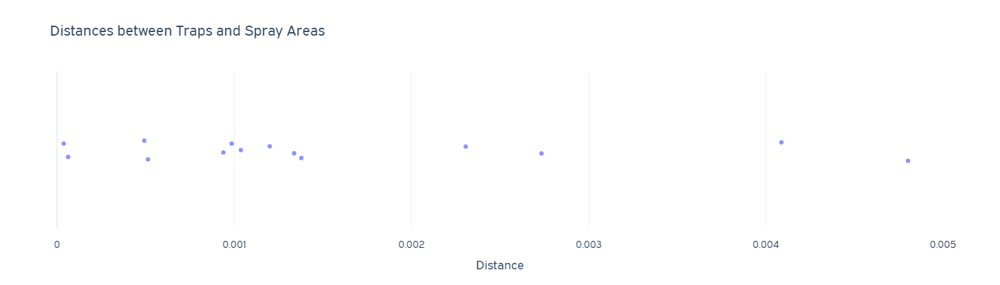

In [47]:
(express
 .strip(trap_sprayed,
        x="Distance",
        range_x=[0, 0.005],
        title="Distances between Traps and Spray Areas")
 .prettify()
 .render())

**FYI:** You can double-click to zoom in/out automatically.

In [48]:
trap_sprayed["Location"] = trap_sprayed["Distance"].map(lambda x: "Trap Sprayed" if x < 0.003 else "Trap Normal")

In [49]:
trap_sprayed.head()

,Date,Trap,Species,Latitude,Longitude,NumMosquitos,WnvPresent,Distance,Location
0,2013-07-25,T002,CULEX PIPIENS,41.954690,-87.800991,3,0,0.061396,Trap Normal
1,2013-07-25,T003,CULEX RESTUANS,41.964242,-87.757639,16,0,0.018215,Trap Normal
2,2013-07-25,T008,CULEX PIPIENS/RESTUANS,42.008314,-87.777921,49,0,0.057317,Trap Normal
3,2013-07-25,T009,CULEX PIPIENS/RESTUANS,41.992478,-87.862995,23,0,0.127174,Trap Normal
4,2013-07-25,T011,CULEX PIPIENS/RESTUANS,41.944869,-87.832763,4,0,0.094140,Trap Normal


In [50]:
trap_sprayed["Location"].value_counts()

Trap Normal     347
Trap Sprayed     12
Name: Location, dtype: int64

In [51]:
# Take out the spray data on observed dates.
spray_observed = spray[spray["Date"].isin(train["Date"])]

In [52]:
spray_observed.head()

,Date,Latitude,Longitude
4411,2013-07-25,41.960520,-87.739783
4412,2013-07-25,41.960515,-87.739787
4413,2013-07-25,41.960508,-87.739787
4414,2013-07-25,41.960498,-87.739792
4415,2013-07-25,41.960527,-87.739800


In [53]:
spray_observed.shape

(9359, 3)

In [54]:
# Assign the label to the observed spray data.
spray_observed["Location"] = "Spray"

In [55]:
spray_observed.head()

,Date,Latitude,Longitude,Location
4411,2013-07-25,41.960520,-87.739783,Spray
4412,2013-07-25,41.960515,-87.739787,Spray
4413,2013-07-25,41.960508,-87.739787,Spray
4414,2013-07-25,41.960498,-87.739792,Spray
4415,2013-07-25,41.960527,-87.739800,Spray


In [56]:
# Append the observed spray data to the sprayed trap data.
train_spray = pd.concat([trap_sprayed, spray_observed])

In [57]:
train_spray.head()

,Date,Trap,Species,Latitude,Longitude,NumMosquitos,WnvPresent,Distance,Location
0,2013-07-25,T002,CULEX PIPIENS,41.954690,-87.800991,3.0,0.0,0.061396,Trap Normal
1,2013-07-25,T003,CULEX RESTUANS,41.964242,-87.757639,16.0,0.0,0.018215,Trap Normal
2,2013-07-25,T008,CULEX PIPIENS/RESTUANS,42.008314,-87.777921,49.0,0.0,0.057317,Trap Normal
3,2013-07-25,T009,CULEX PIPIENS/RESTUANS,41.992478,-87.862995,23.0,0.0,0.127174,Trap Normal
4,2013-07-25,T011,CULEX PIPIENS/RESTUANS,41.944869,-87.832763,4.0,0.0,0.094140,Trap Normal


In [58]:
train_spray.tail()

,Date,Trap,Species,Latitude,Longitude,NumMosquitos,WnvPresent,Distance,Location
13906,2013-08-29,NaN,NaN,41.980493,-87.684137,NaN,NaN,NaN,Spray
13907,2013-08-29,NaN,NaN,41.980085,-87.684428,NaN,NaN,NaN,Spray
13908,2013-08-29,NaN,NaN,41.980050,-87.685138,NaN,NaN,NaN,Spray
13909,2013-08-29,NaN,NaN,41.979912,-87.685593,NaN,NaN,NaN,Spray
13910,2013-08-29,NaN,NaN,41.979600,-87.686018,NaN,NaN,NaN,Spray


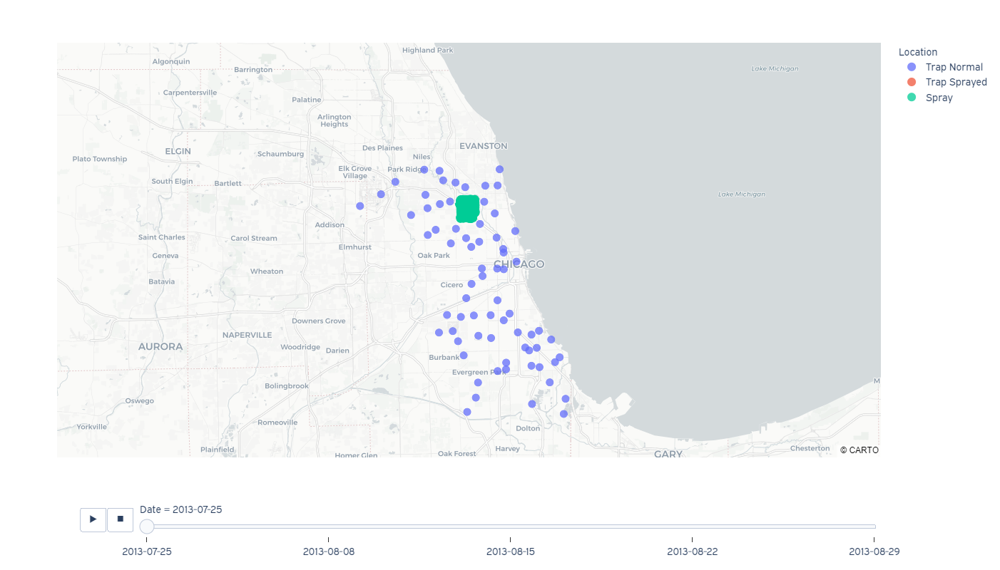

In [68]:
(express
 .scatter_mapbox(train_spray, 
                 lat="Latitude", 
                 lon="Longitude", 
                 color="Location", 
                 animation_frame="Date") 
 .deep_apply(["layout", "sliders", 0, "currentvalue", "prefix"], lambda x: x.replace("=", " = "))
 .prettify()
 .update_layout(mapbox={"center": {"lat": train_spray["Latitude"].mean(), 
                                   "lon": train_spray["Longitude"].mean()}, 
                        "style": "carto-positron", 
                        "zoom": 9},
                 width=800, 
                 height=800)
 .update_traces(marker={"size": 12})
 .render())

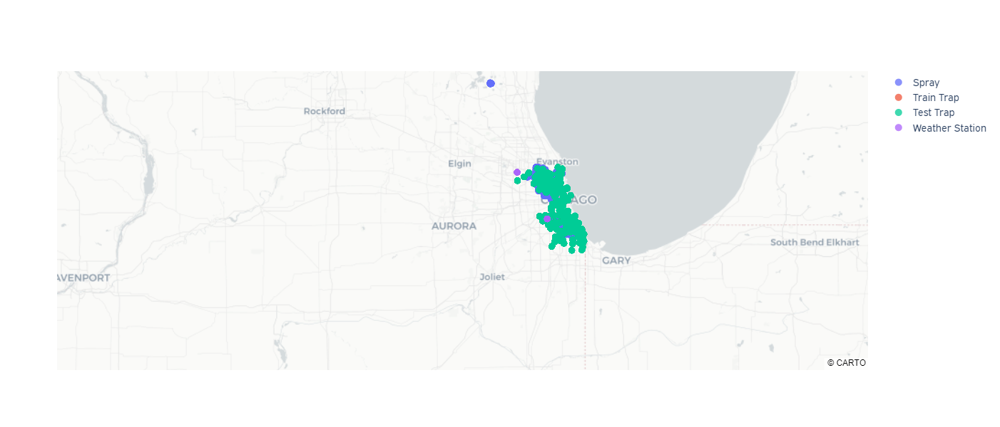

In [35]:
(Figure()
 .add_scattermapbox(name="Spray", 
                    lat=spray["Latitude"], 
                    lon=spray["Longitude"])
 .add_scattermapbox(name="Train Trap", 
                    lat=train["Latitude"], 
                    lon=train["Longitude"])
 .add_scattermapbox(name="Test Trap", 
                    lat=test["Latitude"], 
                    lon=test["Longitude"])
 .add_scattermapbox(name="Weather Station", 
                    lat=weather["Latitude"], 
                    lon=weather["Longitude"],
                    customdata=weather["Station"])
 .prettify()
 .update_layout(mapbox={"center": {"lat": 42.02, 
                                   "lon": -87.85}, 
                        "style": "carto-positron", 
                        "zoom": 8},
                width=800, 
                height=600)
 .update_traces(hovertemplate="<br>".join(map_preset))
 .update_traces(hovertemplate="<br>".join(["Station: %{customdata}", 
                                           *map_preset]), 
                selector={"name": "Weather Station"})
 .update_traces(marker={"size": 10})
 .render())

Drop outlier spray locations.

In [36]:
spray[spray["Longitude"] <= -88]

,Date,Latitude,Longitude
0,2011-08-29,42.391623,-88.089163
1,2011-08-29,42.391348,-88.089163
2,2011-08-29,42.391022,-88.089157
3,2011-08-29,42.390637,-88.089158
4,2011-08-29,42.390410,-88.088858
...,...,...,...
90,2011-08-29,42.392902,-88.093853
91,2011-08-29,42.392587,-88.093867
92,2011-08-29,42.392308,-88.093873
93,2011-08-29,42.392183,-88.093767


In [37]:
spray = spray[spray["Longitude"] > -88]

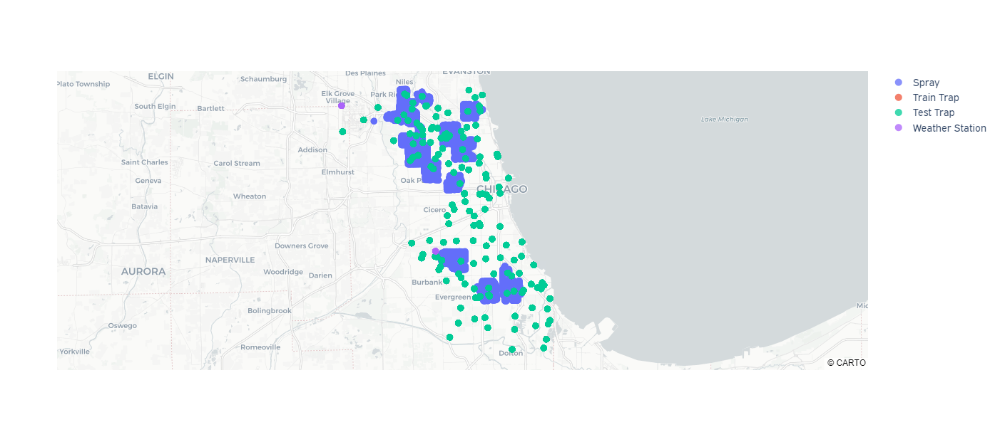

In [38]:
(Figure()
 .add_scattermapbox(name="Spray", 
                    lat=spray["Latitude"], 
                    lon=spray["Longitude"])
 .add_scattermapbox(name="Train Trap", 
                    lat=train["Latitude"], 
                    lon=train["Longitude"])
 .add_scattermapbox(name="Test Trap", 
                    lat=test["Latitude"], 
                    lon=test["Longitude"])
 .add_scattermapbox(name="Weather Station", 
                    lat=weather["Latitude"], 
                    lon=weather["Longitude"],
                    customdata=weather["Station"])
 .prettify()
 .update_layout(mapbox={"center": {"lat": 41.83, 
                                   "lon": -87.70}, 
                        "style": "carto-positron", 
                        "zoom": 9},
                width=800, 
                height=600)
 .update_traces(hovertemplate="<br>".join(preset))
 .update_traces(hovertemplate="<br>".join(["Station=%{customdata}", *preset]), 
                selector={"name": "Weather Station"})
 .update_traces(marker={"size": 10})
 .hide_widgets())

I think the cutoff distance should be 0.002. Any trap with distance less than 0.002 from the nearest spray area is considered sprayed and thus, is expected to find less mosquitos.